In [45]:
import os
import pygmt
import pandas as pd
import xarray as xr
import numpy as np
from scripts import mapOutputs as mout

import matplotlib.pyplot as plt
%matplotlib inline

## Running the simulations

To run the different simulations, you will need to do the following in a terminal:

```bash
mpirun -np X python3 runModel.py -i input-global_refined.yml 
```

where X is the number of processors to use (for example 10).

## Visualising the outputs

You can visualise the outputs of your simulations directly in Paraview. Below we also show how this could be extracted as netcdf grids and analysed in Python.


To do so, we will be using the `mapOutputs` Python class (available in the `scripts` folder) to first extract the outputs, remap the unstructured variables on a structured mesh. The class is also performing additional calculations on the dataset to extract individual catchments based on flow accumulation and elevation.

The interpolated model's variables are then exported as `netCDF` files, and each of them contains the following (if available from the simulation):

+ elevation `elevation` (m)
+ cumulative erosion/deposition `erodep` (m)
+ erosion/deposition rate `erodep_rate` (m/yr)
+ water flux discharge (accounting for lakes) `fillDischarge`(m3/yr)
+ sediment flux in rivers `sedimentLoad` (m3/yr)
+ main basin ids `basinID` (integer)
+ rainfall `precipitation` (m/yr)
+ tectonic `uplift` (m/yr)
+ cumulative flexural isostasy `flex` (m)
  

We first define a folder where exported files will be stored:

In [2]:
# Define output folder name for the simulation
out_path = 'export'

if not os.path.exists(out_path):
    os.makedirs(out_path)

Then we will be using the `mapOutputs` Python class to first extract the outputs, remap the unstructured variables on a structured mesh (the resolution of this mesh is defined by the `reso` parameter set in degree). The class is also performing additional calculations on the dataset to extract individual catchments based on flow accumulation and elevation.

The interpolated model's variables are then exported as `netCDF` files, and each of them contains the following:

+ elevation `elevation` (m)
+ cumulative erosion/deposition `erodep` (m)
+ water flux discharge (accounting for lakes) `fillDischarge`(m3/yr)
+ water flux in rivers (not showing lakes) `flowDischarge` (m3/yr)
+ sediment flux in rivers `sedimentLoad` (m3/yr)
+ main basin ids `basinID` (integer)
+ rainfall `precipitation` (m/yr)
+ tectonic `uplift` (m/yr)

In [3]:
stp = 0

# Resolution of the netcdf structured grid
reso = 0.1

# Name of each netcdf output file
ncout = os.path.join(out_path, "data")

# Initialisation of the class
grid = mout.mapOutputs(path='./', filename='input-global_refined.yml', step=stp, uplift=False, flex=False)

We perform the export using the following loop:

In [4]:
for k in range(0,11):
    
    if stp>1:
        # Get goSPL variables
        grid.getData(stp)
        
    # Remap the variables on the regular mesh using distance weighting interpolation
    grid.buildLonLatMesh(res=reso, nghb=3)
    
    # Export corresponding regular mesh variables as netCDF file
    grid.exportNetCDF(ncfile = ncout+str(k)+'.nc')
    stp += 1

# Plotting some outputs

In [7]:
dataset1 = xr.open_dataset(out_path+'/data1.nc')
dataset5 = xr.open_dataset(out_path+'/data5.nc')
dataset10 = xr.open_dataset(out_path+'/data10.nc')


### Robinson projection

/var/folders/n3/vd5l_ngx2hl52j9g7wgj3dqh0000gn/T/ipykernel_89605/2789692043.py:8: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(


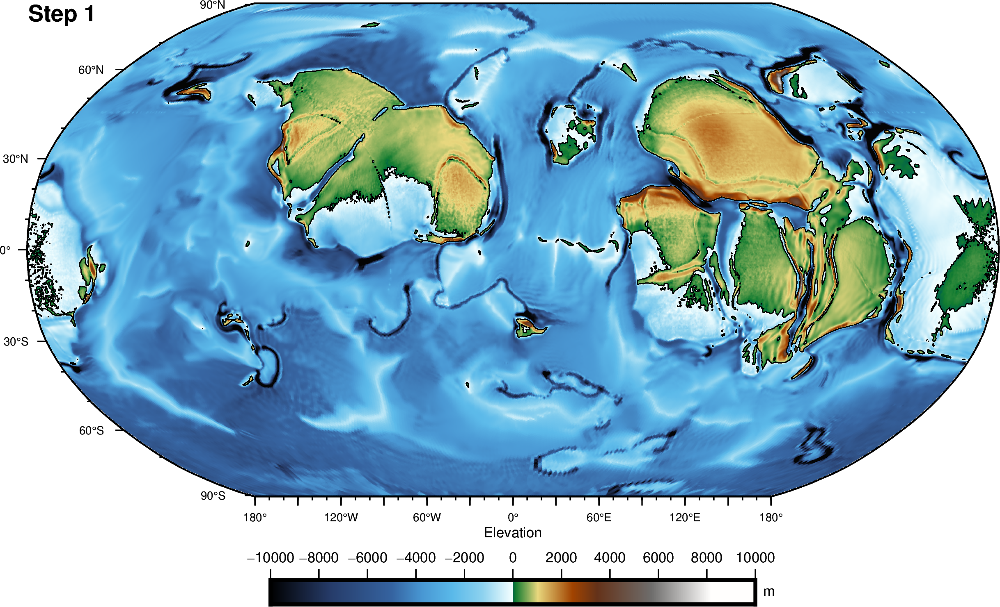

/var/folders/n3/vd5l_ngx2hl52j9g7wgj3dqh0000gn/T/ipykernel_89605/2789692043.py:29: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(


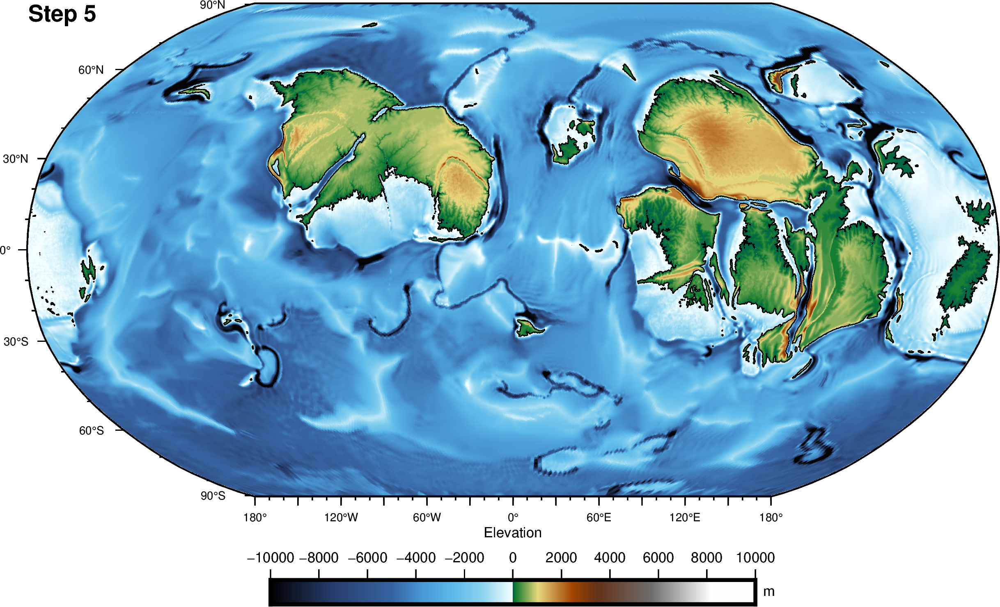

/var/folders/n3/vd5l_ngx2hl52j9g7wgj3dqh0000gn/T/ipykernel_89605/2789692043.py:50: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(


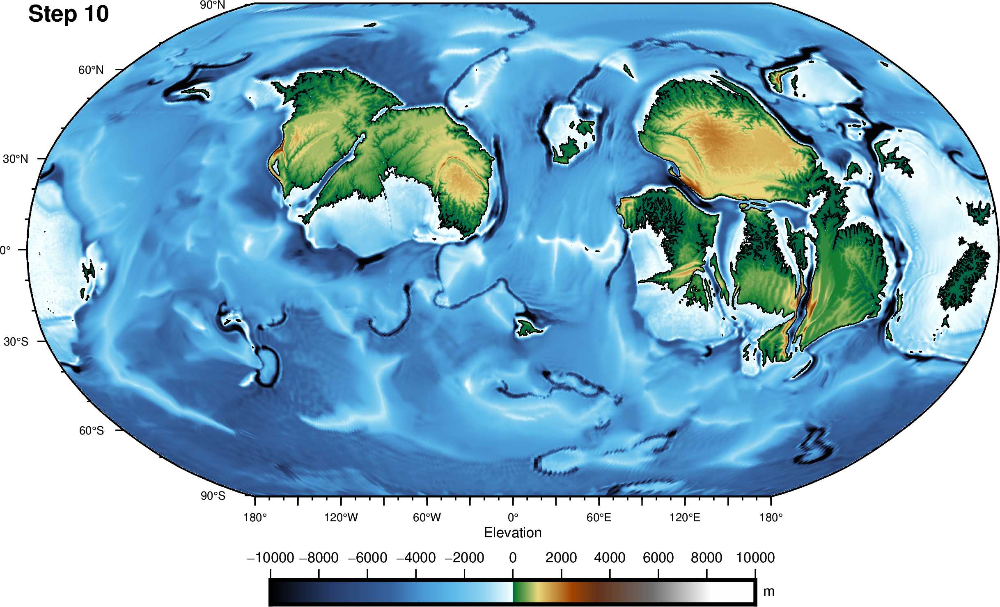

In [8]:
fig = pygmt.Figure()
# Plotting elevation
with pygmt.config(FONT='4p,Helvetica,black'):
    pygmt.makecpt(cmap="geo", series=[-10000, 10000])
    fig.basemap(region='d', projection='N12c', frame='afg')
    fig.grdimage(dataset1.elevation, shading='+a45+nt1', frame=False)
    # Add contour
    fig.grdcontour(
        interval=0.1,
        grid=dataset1.elevation,
        limit=[-0.1, 0.1],
    )
# Add color bar
with pygmt.config(FONT='5p,Helvetica,black'):    
    fig.colorbar(position="jBC+o0c/-1.35c+w6c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])
# At time step
fig.text(text="Step 1", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")
fig.show(dpi=500, width=1000)

#####

fig = pygmt.Figure()
# Plotting elevation
with pygmt.config(FONT='4p,Helvetica,black'):
    pygmt.makecpt(cmap="geo", series=[-10000, 10000])
    fig.basemap(region='d', projection='N12c', frame='afg')
    fig.grdimage(dataset5.elevation, shading='+a45+nt1', frame=False)
    # Add contour
    fig.grdcontour(
        interval=0.1,
        grid=dataset5.elevation,
        limit=[-0.1, 0.1],
    )
# Add color bar
with pygmt.config(FONT='5p,Helvetica,black'):    
    fig.colorbar(position="jBC+o0c/-1.35c+w6c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])
# At time step
fig.text(text="Step 5", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")
fig.show(dpi=500, width=1000)

#####

fig = pygmt.Figure()
# Plotting elevation
with pygmt.config(FONT='4p,Helvetica,black'):
    pygmt.makecpt(cmap="geo", series=[-10000, 10000])
    fig.basemap(region='d', projection='N12c', frame='afg')
    fig.grdimage(dataset10.elevation, shading='+a45+nt1', frame=False)
    # Add contour
    fig.grdcontour(
        interval=0.1,
        grid=dataset10.elevation,
        limit=[-0.1, 0.1],
    )
# Add color bar
with pygmt.config(FONT='5p,Helvetica,black'):    
    fig.colorbar(position="jBC+o0c/-1.35c+w6c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])
# At time step
fig.text(text="Step 10", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")
fig.show(dpi=500, width=1000)

### Mollweide projection

/var/folders/n3/vd5l_ngx2hl52j9g7wgj3dqh0000gn/T/ipykernel_89605/3445541850.py:8: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(


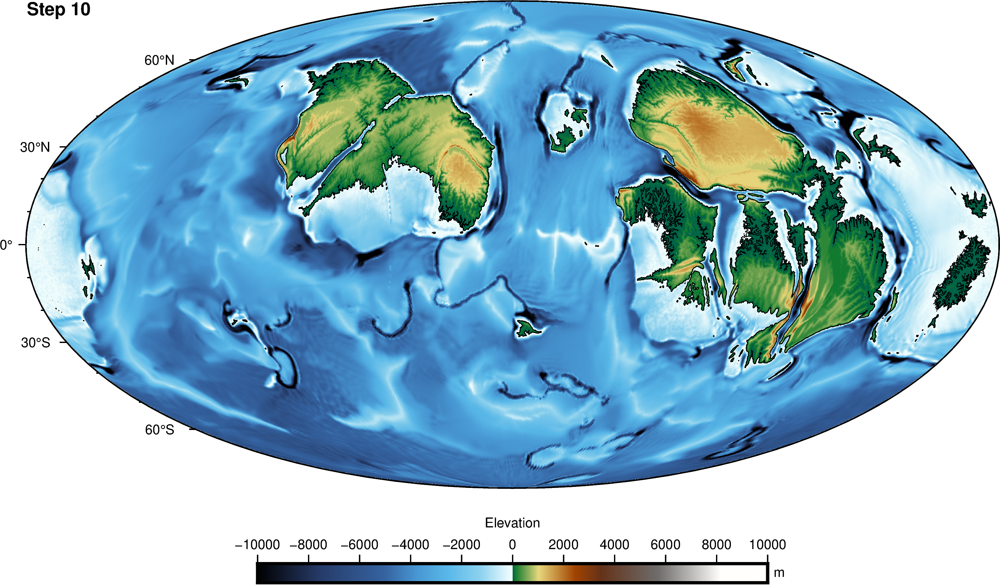

In [9]:
fig = pygmt.Figure()
# Plotting elevation
with pygmt.config(FONT='6p,Helvetica,black'):
    pygmt.makecpt(cmap="geo", series=[-10000, 10000])
    fig.basemap(region='d', projection='W6i', frame='afg')
    fig.grdimage(dataset10.elevation, shading='+a345+nt1+m0', frame=False)
    # Add contour
    fig.grdcontour(
        interval=0.1,
        grid=dataset10.elevation,
        limit=[-0.1, 0.1],
    )
    fig.colorbar(position="jBC+o0c/-1.5c+w8c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])
# Customising the font style
fig.text(text="Step 10", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")
fig.show(dpi=500, width=1000)

/var/folders/n3/vd5l_ngx2hl52j9g7wgj3dqh0000gn/T/ipykernel_89605/1833603419.py:8: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(


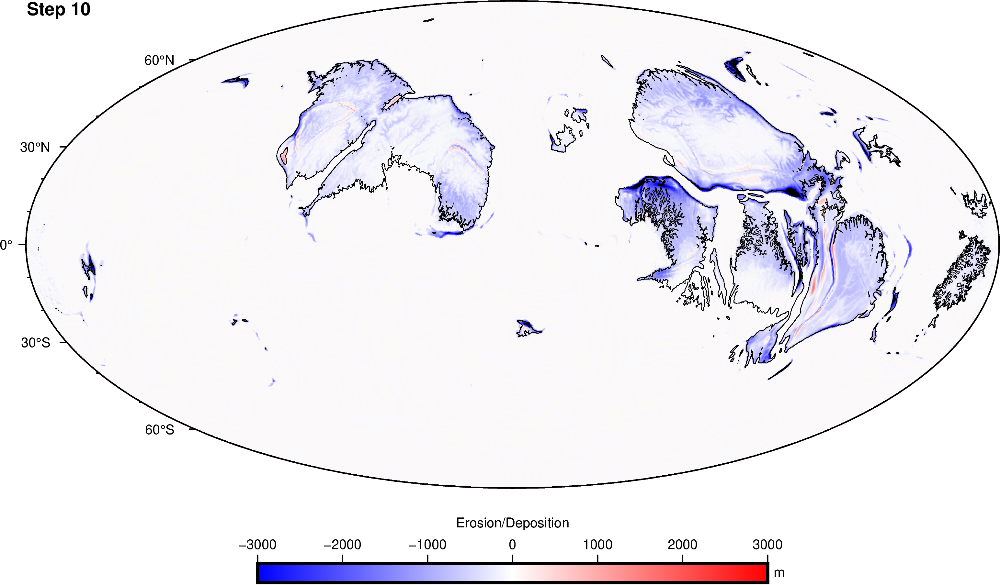

In [11]:
fig = pygmt.Figure()
# Plotting elevation
with pygmt.config(FONT='6p,Helvetica,black'):
    pygmt.makecpt(cmap="polar", series=[-3000, 3000])
    fig.basemap(region='d', projection='W6i', frame='afg')
    fig.grdimage(dataset10.erodep, shading='+a345+nt1+m0', frame=False)
    # Add contour
    fig.grdcontour(
        interval=0.1,
        grid=dataset10.elevation,
        limit=[-0.1, 0.1],
    )
    fig.colorbar(position="jBC+o0c/-1.5c+w8c/0.3c+h",frame=["a1000", "x+lErosion/Deposition", "y+lm"])
# Customising the font style
fig.text(text="Step 10", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")
fig.show(dpi=500, width=1000)

# Evaluation of major drainage systems

Here we design a workflow to extract for each time step the characteristics of each catchment in terms of sediment and water fluxes. The operation is performed globally.

> To avoid having to read the large netcdf file at each time step, we first create a new set of netcdf files with only required variables for the analysis 

In [13]:
# Specify the folder containing the netcdf file from our simulation
out = 'export/'

# Loop over each file and drop unwanted variables
for k in range(0,11,1):
    
    # Open the netcdf file
    dataset = xr.open_dataset(out+'data'+str(k)+'.nc')
    
    # Drop some variables (we only keep the sediment flow fluxes and the basin indices)
    reduce_ds = dataset[['flowDischarge','sedimentLoad','basinID']]
    
    # Save the reduced dataset as a new smaller netcdf
    reduce_ds.to_netcdf(out+'fsdata'+str(k)+'.nc')

We can then use the function `getCatchmentInfo.py` to extract for each individual catchment the maximum fluxes. 

This operation especially when performed globally and over all time steps is slow. The good news is that it is pretty much embarrassingly parallel so we will take advantage of this.

If you want to run it, you can uncomment the following line and run it on 8 cpus (if you actually have 8 cpus on your machine)

The script takes an input file `inputSedFlow.csv` that contains 2 columns: 

+ the first one if the time in Ma and
+ the second is the netcdf file (created above) for each specified time interval.

In [15]:
# !mpirun -np 9 python3 getCatchmentInfo.py -i inputSedFlow.csv -o flowsed

# Extract fluxes (sediment and flow)

Once finished, you will have 2 `csv` files per time step (one for the water discharge and one for the sediment fluxes). Each file contains 4 columns:

+ the first one is the basin index,
+ the second and third ones are the position of the outlet (longitude and latitude respectively),
+ the last column is the corresponding discharge or flux value.

In [23]:
# Pick a time in Ma needs to be a integer
step = 10

# Get the fluxes files 
flowdf = pd.read_csv('flowsed/flow'+str(step)+'.csv')
seddf = pd.read_csv('flowsed/sed'+str(step)+'.csv')

We will use the logarithmic values 

In [24]:
logFA = np.log10(flowdf['val'].values)
logSed = np.log10(seddf['val'].values)

Let's say we want to take the nth-largest values. To do so, we will first sort the values

In [25]:
sorted_index_array = np.argsort(logFA)
sortedFA = logFA[sorted_index_array]
sortedLon = flowdf['lon'].values[sorted_index_array]
sortedLat = flowdf['lat'].values[sorted_index_array]

sorted_index_array1 = np.argsort(logSed)
sortedSed = logSed[sorted_index_array1]
sortedLon1 = seddf['lon'].values[sorted_index_array1]
sortedLat1 = seddf['lat'].values[sorted_index_array1]

We now want to visualise the main fluxes, for example we will look at the 200 largest fluxes:

In [30]:
# Define nth values
nlargest = 200

rLon = sortedLon[-nlargest : ]
rLat = sortedLat[-nlargest : ]
rFA = sortedFA[-nlargest : ]

rLon1 = sortedLon1[-nlargest : ]
rLat1 = sortedLat1[-nlargest : ]
rSed = sortedSed[-nlargest : ]

### Plot for flow

/var/folders/n3/vd5l_ngx2hl52j9g7wgj3dqh0000gn/T/ipykernel_89605/2066095335.py:11: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(


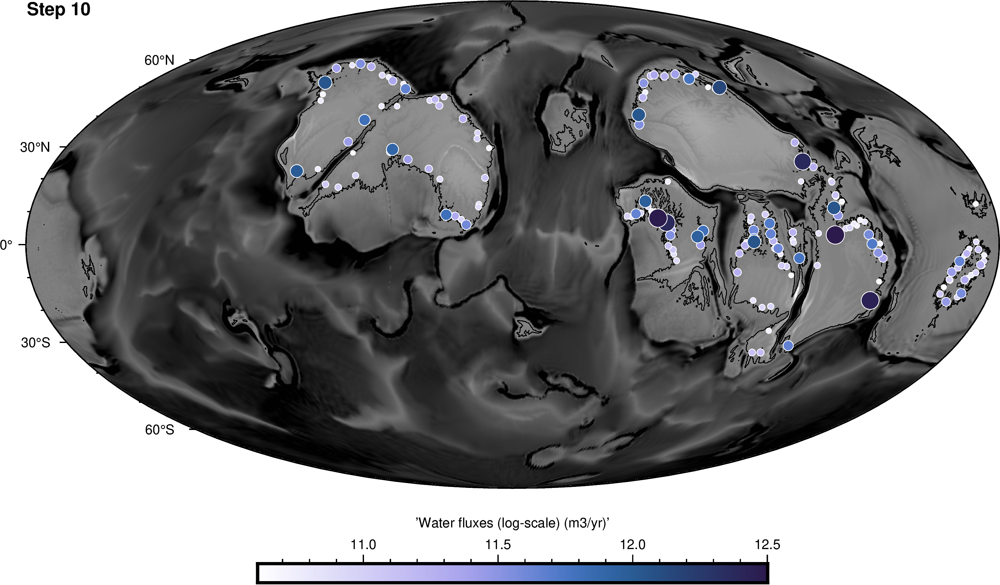

In [38]:
# Let read the initial dataset (this will be used to get the elevation on our plot)
dataset = xr.open_dataset(out+'data'+str(step)+'.nc')

fig = pygmt.Figure()
# Background image
with pygmt.config(FONT='6p,Helvetica,black'):
    pygmt.makecpt(cmap="gray", series=[-6000, 6000])
    fig.basemap(region='d', projection='W6i', frame='afg')
    fig.grdimage(dataset.elevation, shading='+a345+nt1+m0', frame=False)
    
    fig.grdcontour(
        interval=0.1,
        grid=dataset.elevation,
        limit=[-0.1, 0.1],
    )
# Scatter plot
with pygmt.config(FONT='6p,Helvetica,black'):
    pygmt.makecpt(cmap="devon", series=[rFA.min(), rFA.max()], reverse=True)
    fig.plot(
        x=rLon,
        y=rLat,
        style="cc",
        pen="white",
        size=0.00005 * 2 ** rFA,
        fill=rFA,
        cmap=True,
    )
    fig.colorbar(position="jBC+o0c/-1.5c+w8c/0.3c+h", 
                 frame="af+l'Water fluxes (log-scale) (m3/yr)'")
# Time interval
fig.text(text="Step 10", position="TL", font="8p,Helvetica-Bold,black")

fig.show(dpi=500, width=1000)
# fname = 'fluxes/flow'+str(step)+'Ma.png'
# fig.savefig(fname=fname,dpi=500)

### Plot for sed

/var/folders/n3/vd5l_ngx2hl52j9g7wgj3dqh0000gn/T/ipykernel_89605/2597019095.py:8: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(


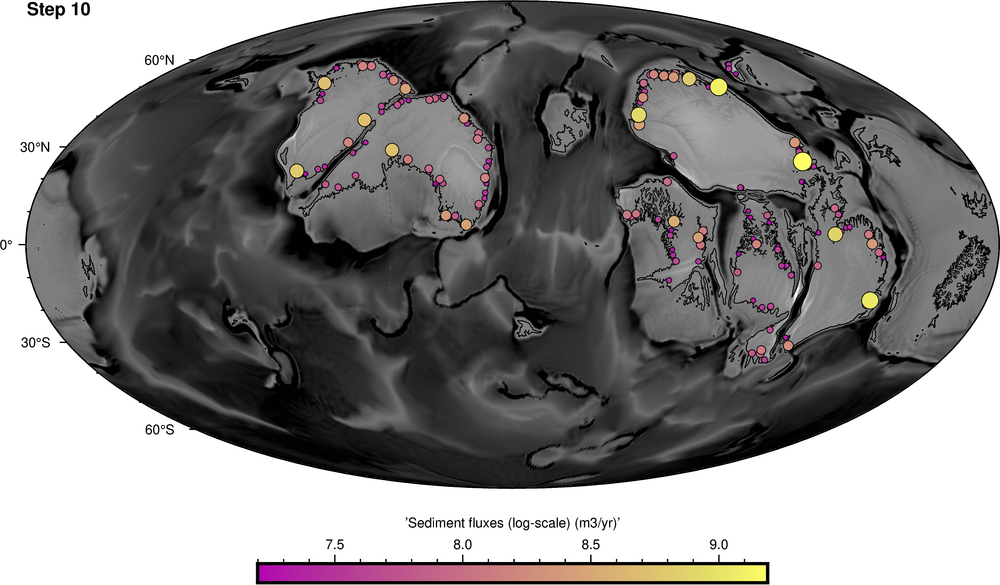

In [37]:
fig = pygmt.Figure()

# Background image
with pygmt.config(FONT='6p,Helvetica,black'):
    pygmt.makecpt(cmap="gray", series=[-6000, 6000])
    fig.basemap(region='d', projection='W6i', frame='afg')
    fig.grdimage(dataset.elevation, shading='+a345+nt1+m0', frame=False)
    fig.grdcontour(
        interval=0.1,
        grid=dataset.elevation,
        limit=[-0.1, 0.1],
    )
# Scatter plot
with pygmt.config(FONT='6p,Helvetica,black'):
    pygmt.makecpt(cmap="buda", series=[rSed.min(), rSed.max()])
    fig.plot(
        x=rLon1,
        y=rLat1,
        style="cc",
        pen="black",
        size=0.0005 * 2 ** rSed,
        fill=rSed,
        cmap=True,
    )
    fig.colorbar(position="jBC+o0c/-1.5c+w8c/0.3c+h", 
                 frame="af+l'Sediment fluxes (log-scale) (m3/yr)'")
# Time interval
fig.text(text="Step 10", position="TL", font="8p,Helvetica-Bold,black")
fig.show(dpi=500, width=1000)
# fname = 'fluxes/sed'+str(step)+'Ma.png'
# fig.savefig(fname=fname,dpi=500)

## Hypsometric curve

The histogram is determined using the equation above used to calculate the area of each cell, and then we group them by elevation and sum them.

In [41]:
def getCellArea(ds):

    res = 0.05
    dlat = res*np.pi/180.
    dlon = res*np.pi/180.
    a = 6378.137
    e = 0.08181919

    lat = ds.latitude.data
    lon = ds.longitude.data

    mlon, mlat = np.meshgrid(lon, lat)
    mlonlat = np.dstack([mlon.flatten(), mlat.flatten()])[0]

    rlat = mlat.flatten()*np.pi/180.
    cellArea = a**2 * np.cos(rlat) * (1. - e**2) * dlat * dlon / (1. - e**2 * np.sin(rlat)**2)**2
    
    return cellArea

cellArea = getCellArea(xr.open_dataset('export/data10.nc'))

In [44]:
def func(x):
    y = np.sum(x)
    return y

time = 0
nbins = 800
bins = np.flip(np.linspace(-5000, 5000, nbins))

zdata = xr.open_dataset('export/data1.nc') #, chunks={'latitude': 500, 'longitude': 500})

elevsim = zdata.elevation.values.flatten()
ind1 = np.digitize(elevsim, bins)
result0 = [func(cellArea[ind1 == j]) for j in range(1, nbins)]
cumRes0 = np.cumsum(result0)
cumRes0 /= cumRes0[-1]

zdata2 = xr.open_dataset('export/data10.nc')
elevpaleo = zdata2.elevation.values.flatten()
ind1 = np.digitize(elevpaleo, bins)
result2 = [func(cellArea[ind1 == j]) for j in range(1, nbins)]
cumRes2 = np.cumsum(result2)
cumRes2 /= cumRes2[-1]

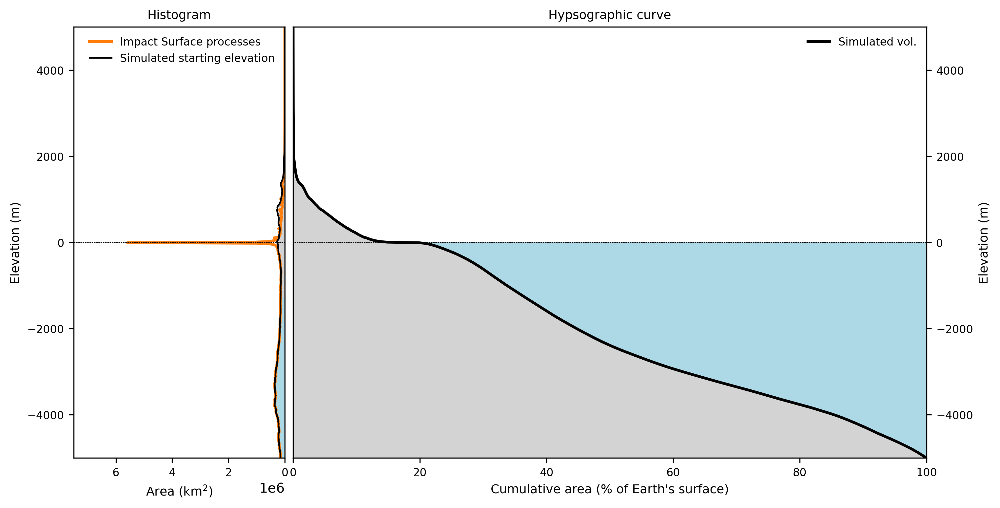

In [55]:
f, (a0, a1) = plt.subplots(1, 2, gridspec_kw={'width_ratios': [1, 3]}, figsize=(10, 5), dpi=300)

plt.xticks(fontsize=8)
plt.yticks(fontsize=8)

# Virtual Earth
a0.plot(result2, bins[1:], '-', color='tab:orange', zorder=2, lw=2, label='Impact Surface processes')
a0.plot(result0, bins[1:], '-', color='k', zorder=2, lw=1.2, label='Simulated starting elevation')
a0.fill_betweenx(bins[500:], 0, result0[499:], color='lightblue')
a0.fill_betweenx(bins[1:501], 0, result0[:500], color='lightgrey')
a0.plot([0,7.5e6],[-5000,-5000], ls='--',c='k',lw=0.25)
a0.plot([0,7.5e6],[0,0], ls='--',c='k',lw=0.25)
a0.plot([0,7.5e6],[5000,5000], ls='--',c='k',lw=0.25)
a0.set_ylabel('Elevation (m)', fontsize=9)
a0.set_xlabel('Area (km$^2$)', fontsize=9)
a0.set_title('Histogram', fontsize=9)
a0.set_xlim([0,7.5e6])
a0.set_ylim([-5000,5000])
a0.legend(frameon=False, prop={'size': 8}, loc=1)
a0.tick_params(axis='both', labelsize=8)
a0.invert_xaxis()

a1.plot(cumRes2*100., bins[1:], '-', color='k', zorder=2, lw=2, label='Simulated vol.')
a1.legend(frameon=False, prop={'size': 8}, loc=1)
a1.yaxis.set_label_position("right")
a1.yaxis.tick_right()
a1.set_ylabel('Elevation (m)', fontsize=9)
a1.set_xlabel("Cumulative area (% of Earth's surface)", fontsize=9)
a1.set_title('Hypsographic curve', fontsize=9)
a1.set_xlim([0,100])
a1.set_ylim([-5000,5000])
a1.plot([0,2.5e6],[-5000,-5000], ls='--', c='k',lw=0.25)
a1.plot([0,2.5e6],[0,0], ls='--', c='k',lw=0.25)
a1.plot([0,2.5e6],[5000,5000],ls='--', c='k',lw=0.25)
a1.legend(frameon=False, prop={'size': 8}, loc=1)
a1.tick_params(axis='both', labelsize=8)
a1.fill_between(cumRes2*100., bins[1:], 0, color='lightblue')
a1.fill_between(cumRes2*100.,-10000, bins[1:], color='lightgrey')
f.tight_layout(pad=0.1)
# plt.savefig('hypsometry.pdf')
plt.show()